In [1]:
import tribolium_clustering as tc
import pyclesperanto_prototype as cle
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import umap
import hdbscan
import napari

wolgast = tc.processed_dataset(tc.get_folder_path('Wolgast'))
finster = tc.processed_dataset(tc.get_folder_path('Finsterwalde'))
embeddings_wolgast_folder = tc.get_folder_path('wolgast embedding folder')
embeddings_finster_folder = tc.get_folder_path('Finsterwalde embedding folder')

In [2]:
embeddings_wolgast = [np.load(embeddings_wolgast_folder + 
                              'embedding of t{} Wolgast (nneigh = 400, mindist = 0).npy'.format(i)) 
                      for i in range(32)]
embeddings_finster = [np.load(embeddings_finster_folder + 
                              'embedding of t{} Finsterwalde (nneigh = 400, mindist = 0).npy'.format(i)) 
                      for i in range(32)]

FileNotFoundError: [Errno 2] No such file or directory: 'C:/Users/ryans/OneDrive/Documents/Master Thesis/Documents/Figures/Embryo Serosa Clustering Wolgast//embedding of t0 Wolgast (nneigh = 400, mindist = 0).npy'

# Wolgast Clustering

In [3]:
clusterer_wolgast = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, approx_min_span_tree=True,
    gen_min_span_tree=False, leaf_size=40,
    metric='euclidean', min_cluster_size=20, min_samples=None, p=None)

t0_cluster_test = clusterer_wolgast.fit_predict(embeddings_wolgast[26])
t0_orig_image = wolgast.get_intensity_image(26)
t0_labels = wolgast.get_labels(26)


cluster_img_test = tc.generate_parametric_cluster_image(predictionlist=t0_cluster_test,
                                                        gpu_labelimage=cle.push(t0_labels),
                                                        labelimage=t0_labels)

viewer = napari.Viewer(ndisplay=3)
viewer.add_image(t0_orig_image)
viewer.add_labels(cluster_img_test)

NameError: name 'embeddings_wolgast' is not defined

stable embryo serosa clustering not really possible with this method - try again with complete UMAPs that we optimise for serosa embryo differentiation

In [14]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

thesis_deleted_keys = ['convex_area','euler_number', 'weighted_centroid-0',
                       'weighted_centroid-1', 'weighted_centroid-2', 'filled_area',
                      ]

complete_regionprops_wolgast = wolgast.get_combined_regionprops()
complete_regionprops_wolgast = complete_regionprops_wolgast.drop(thesis_deleted_keys,axis=1)
complete_regionprops_wolgast = tc.min_maj_ax_to_aspectr(complete_regionprops_wolgast, del_min_maj=False)
corr_filtered_wolgast = tc.correlating_feature_filter(complete_regionprops_wolgast, threshold= 0.95)

scaled_complete_wolgast = scaler.fit_transform(corr_filtered_wolgast)

#chosen: AREA, equ_diam, minaxlength; FERET DIAMETER, major axis length; avg and standard deviation of 6 

No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//


In [15]:
umap_reducer = umap.UMAP(
                         n_neighbors=400,
                         min_dist=0.0,
                         )

wolgast_total_embedding = umap_reducer.fit_transform(scaled_complete_wolgast)

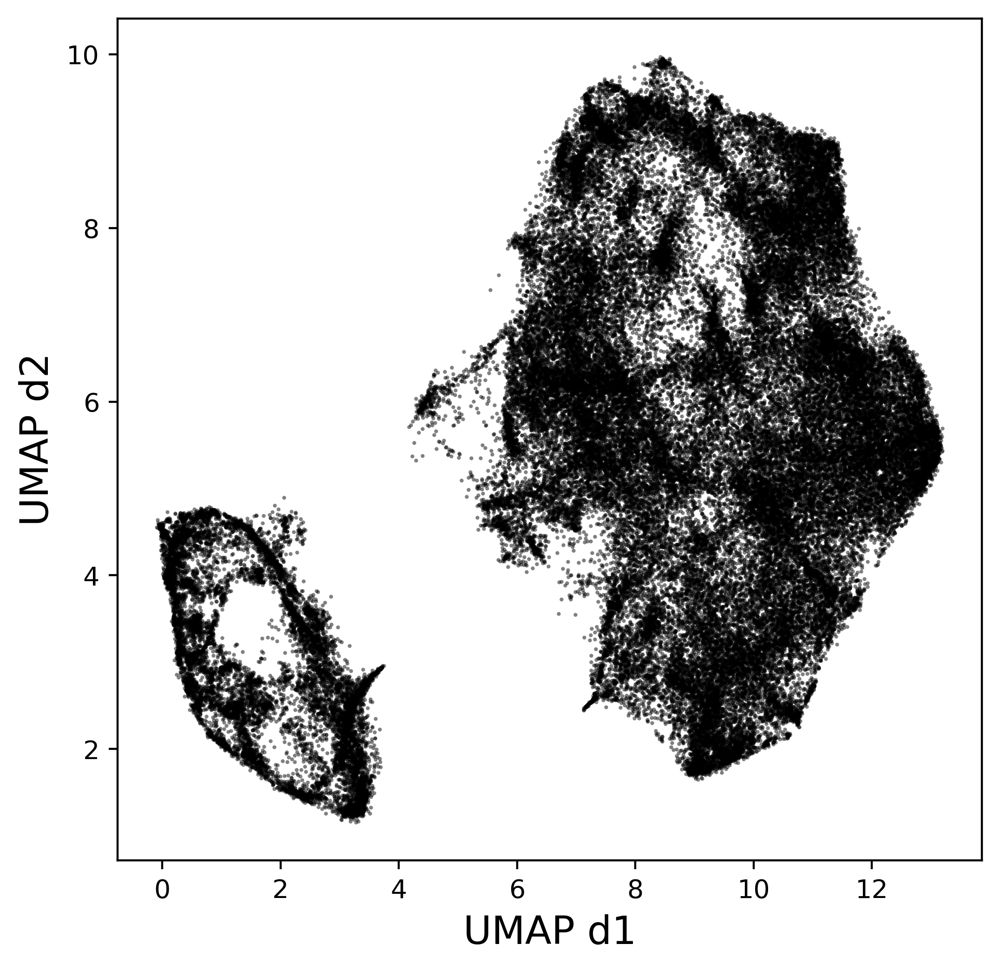

In [16]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 400

spot_size = 0.25
font_size_title = 18
font_size_axis = 15


fig, axs = plt.subplots(1,1, figsize = (6,6))

axs.scatter(wolgast_total_embedding[:,0],
            wolgast_total_embedding[:,1], 
            s = spot_size, c = 'black', alpha = 0.5)
    
axs.set_xlabel('UMAP d1', fontsize =font_size_axis)
axs.set_ylabel('UMAP d2', fontsize =font_size_axis)
plt.show()

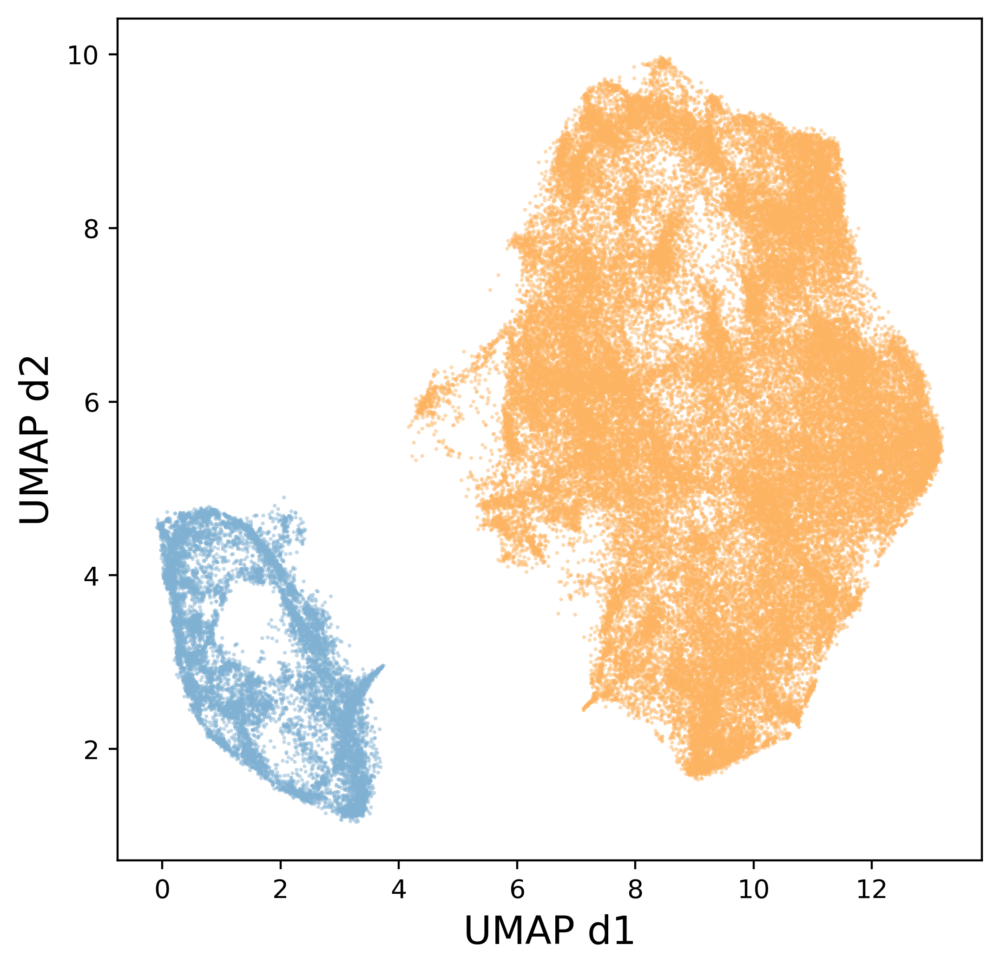

In [18]:
hdb_predictions_wolgast = clusterer_wolgast.fit_predict(wolgast_total_embedding)

cmap_plots = tc.plot_cmap()

fig, axs = plt.subplots(1,1, figsize = (6,6))

axs.scatter(wolgast_total_embedding[:,0],
            wolgast_total_embedding[:,1], 
            s = spot_size, 
            c = [cmap_plots[j] for j in hdb_predictions_wolgast], 
            alpha = 0.5)
    
axs.set_xlabel('UMAP d1', fontsize =font_size_axis)
axs.set_ylabel('UMAP d2', fontsize =font_size_axis)
plt.show()

In [20]:
import pyclesperanto_prototype as cle

timepoint = 15

workflow_wolgast = wolgast.get_labels(timepoint)
image_wolgast = wolgast.get_intensity_image(timepoint)
indices_wolgast = wolgast.cumulative_label_lengths()

cluster_image_wolgast = tc.generate_parametric_cluster_image(workflow_wolgast, 
                                                             cle.push(workflow_wolgast),
                                                             hdb_predictions_wolgast[indices_wolgast[timepoint]:indices_wolgast[timepoint+1]]
                                                            )
cmap_napari = tc.napari_label_cmap()

viewer = napari.Viewer(ndisplay=3)
viewer.add_image(image_wolgast)
viewer.add_labels(cluster_image_wolgast, color = cmap_napari)

No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//


<Labels layer 'cluster_image_wolgast' at 0x1c77cfd92e0>

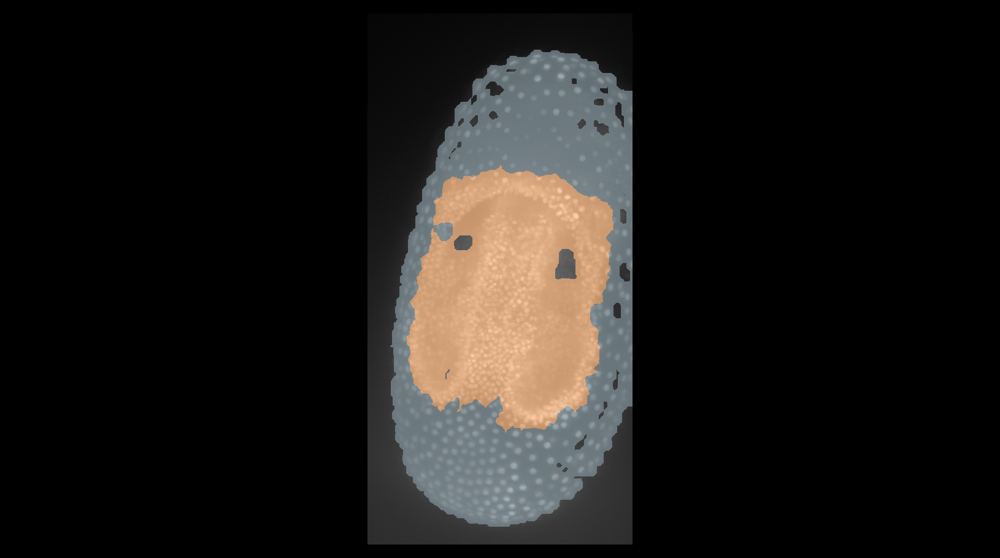

In [22]:
napari.utils.nbscreenshot(viewer,canvas_only=True)

That's more like it. now we need to do the same thing with finsterwalde and lund and then iterate over timepoints.

In [23]:
corr_filtered_wolgast.keys()

Index(['area', 'bbox_area', 'extent', 'feret_diameter_max', 'max_intensity',
       'mean_intensity', 'min_intensity', 'solidity', 'centroid-0',
       'centroid-1', 'centroid-2', 'image_stdev',
       'avg distance of 6 closest points',
       'stddev distance of 6 closest points', 'touching neighbor count',
       'aspect_ratio'],
      dtype='object')

In [26]:
selection_test = complete_regionprops_wolgast[['area', 'bbox_area', 'extent', 'feret_diameter_max', 'max_intensity',
                                              'mean_intensity', 'min_intensity', 'solidity', 'centroid-0',
                                              'centroid-1', 'centroid-2', 'image_stdev',
                                              'avg distance of 6 closest points',
                                              'stddev distance of 6 closest points', 'touching neighbor count',
                                              'aspect_ratio'
                                              ]]
selection_test.keys()

Index(['area', 'bbox_area', 'extent', 'feret_diameter_max', 'max_intensity',
       'mean_intensity', 'min_intensity', 'solidity', 'centroid-0',
       'centroid-1', 'centroid-2', 'image_stdev',
       'avg distance of 6 closest points',
       'stddev distance of 6 closest points', 'touching neighbor count',
       'aspect_ratio'],
      dtype='object')

In [27]:
lund = tc.processed_dataset(tc.get_folder_path('lund'))
complete_regionprops_lund = lund.get_combined_regionprops()
complete_regionprops_lund = tc.min_maj_ax_to_aspectr(complete_regionprops_lund, del_min_maj=False)


complete_regionprops_finster = finster.get_combined_regionprops()
complete_regionprops_finster = tc.min_maj_ax_to_aspectr(complete_regionprops_finster, del_min_maj=False)

allregprops = [complete_regionprops_lund,complete_regionprops_wolgast,complete_regionprops_finster]

No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Lund Gastrulation Correct voxel sizes//
No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Finsterwalde Gastrulation Labels (new timeframe)//


In [28]:
def embryo_serosa_preprocessing(regprops):
    from sklearn.preprocessing import StandardScaler
    import umap
    
    subselection = ['area', 'bbox_area', 'extent', 'feret_diameter_max', 'max_intensity',
                    'mean_intensity', 'min_intensity', 'solidity', 'centroid-0',
                    'centroid-1', 'centroid-2', 'image_stdev',
                    'avg distance of 6 closest points',
                    'stddev distance of 6 closest points', 'touching neighbor count',
                    'aspect_ratio']
    subselected = regprops[subselection]
    
    scaler = StandardScaler()
    scaled = scaler.fit_transform(subselected)
    
    umap_object = umap.UMAP(
                         n_neighbors=400,
                         min_dist=0.0,
                         random_state=42)

    processed_embedding = umap_object.fit_transform(scaled)
    
    return processed_embedding

preprocessed_embeddings = [embryo_serosa_preprocessing(prop) for prop in allregprops]

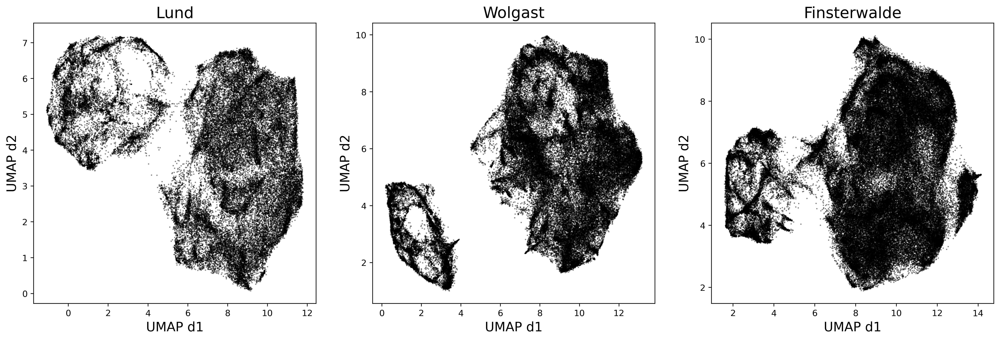

In [31]:
titles = ['Lund', 'Wolgast', 'Finsterwalde']

fig, axs = plt.subplots(1,3, figsize = (20,6))
for i,embed in enumerate(preprocessed_embeddings):
    axs[i].scatter(embed[:,0],embed[:,1], s = spot_size, c = 'black', alpha = 0.5)
    axs[i].set_title(titles[i], fontsize = font_size_title)
    axs[i].set_xlabel('UMAP d1', fontsize =font_size_axis)
    axs[i].set_ylabel('UMAP d2', fontsize =font_size_axis)
plt.show()

In [34]:
clusterer_all = hdbscan.HDBSCAN(algorithm='best', alpha=1.0, approx_min_span_tree=True,
                                gen_min_span_tree=False, leaf_size=40,
                                metric='euclidean', min_cluster_size=2000, 
                                min_samples=None, p=None)
predictions = [clusterer_all.fit_predict(embed) for embed in preprocessed_embeddings]

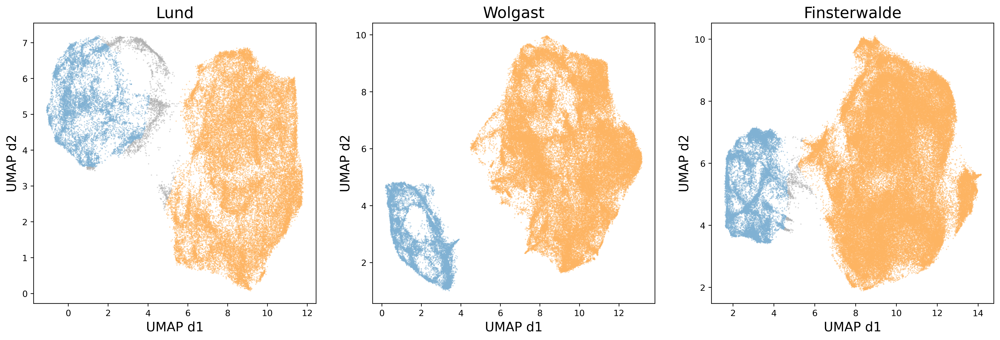

In [35]:
fig, axs = plt.subplots(1,3, figsize = (20,6))
for i,embed in enumerate(preprocessed_embeddings):
    axs[i].scatter(embed[:,0],embed[:,1], s = spot_size, c = [cmap_plots[j] for j in predictions[i]], alpha = 0.5)
    axs[i].set_title(titles[i], fontsize = font_size_title)
    axs[i].set_xlabel('UMAP d1', fontsize =font_size_axis)
    axs[i].set_ylabel('UMAP d2', fontsize =font_size_axis)
plt.show()

C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data is displayed without applying an out-of-slice rotation or shear component.
  warnings.warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data is displayed without applying an out-of-slice rotation or shear component.
  warnings.warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data is displayed without applying an out-of-slice rotation or shear component.
  warnings.warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data is displayed wit

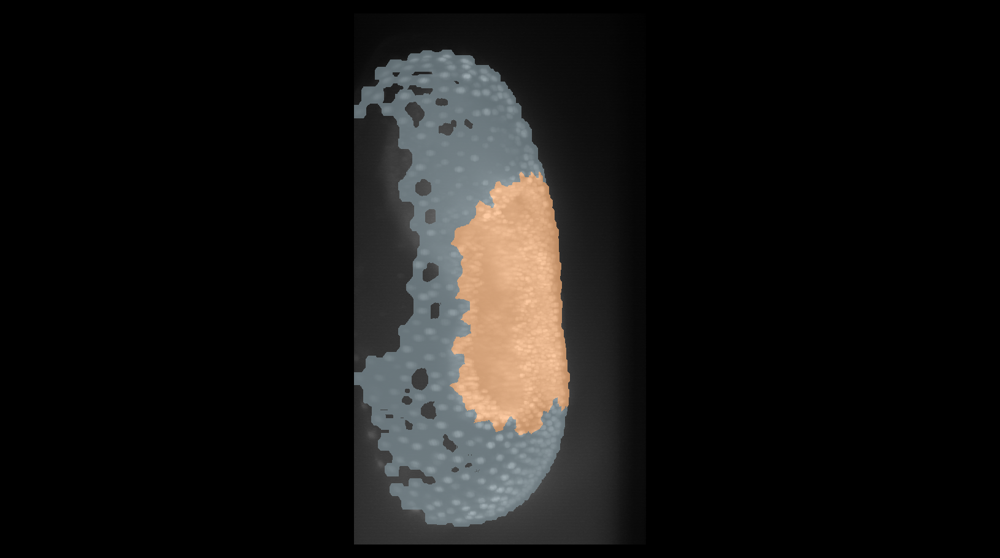

In [45]:
viewer = napari.Viewer(ndisplay=3)
viewer.add_image(image_wolgast, rotate = (0,230,0))
viewer.add_labels(cluster_image_wolgast, color = cmap_napari, rotate = (0,230,0))
napari.utils.nbscreenshot(viewer,canvas_only=True)

In [49]:
rotations_wolgast = [(0,130,0),(0,180,0),(0,230,0)]

def nice_screenshots_of_1_timepoint(dataset, prediction_list, timepoint, 
                                    cmap, save_data_location, name, rotations):
    import napari
    import pyclesperanto_prototype as cle
    from qtpy.QtCore import QTimer
    
    label_image = dataset.get_labels(timepoint)
    intensity_image = dataset.get_intensity_image(timepoint)
    cum_indices = dataset.cumulative_label_lengths()
    
    prediction = prediction_list[cum_indices[timepoint]:cum_indices[timepoint+1]]
    prop = dataset.get_regionprops_timepoint(timepoint)

    regprop_with_predict = pd.concat([prop,pd.DataFrame(prediction, columns = ['prediction'],
                             index = prop.index)], axis = 1)
    regprop_with_predict.to_csv(save_data_location + 'regprops with ' + name +' t{}.csv'.format(timepoint))

    cluster_image = tc.generate_parametric_cluster_image(label_image,cle.push(label_image),prediction)
    
    for i,rot in enumerate(rotations):
        with napari.gui_qt() as app:
            viewer = napari.Viewer(ndisplay=3)
            viewer.add_image(intensity_image, rotate= rot)
            viewer.add_labels(cluster_image, rotate= rot, color = cmap)

            viewer.screenshot(save_data_location + name +' t{}'.format(timepoint) + ' rotation{} .tif'.format(i))

            time_in_msec = 1000
            QTimer().singleShot(time_in_msec, app.quit)
            viewer.close()

            
test_folder = tc.get_folder_path()
nice_screenshots_of_1_timepoint(wolgast,predictions[1],14,cmap_napari,test_folder, 'test', rotations_wolgast)  

No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//
No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//


C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\_qt\qt_event_loop.py:255: FutureWarning: 
The 'gui_qt()' context manager is deprecated.
If you are running napari from a script, please use 'napari.run()' as follows:

    import napari

    viewer = napari.Viewer()  # no prior setup needed
    # other code using the viewer...
    napari.run()

In IPython or Jupyter, 'napari.run()' is not necessary. napari will automatically
start an interactive event loop for you: 

    import napari
    viewer = napari.Viewer()  # that's it!

  warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data is displayed without applying an out-of-slice rotation or shear component.
  warnings.warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data 

# Wolgast Iteration

In [51]:
for time in range(32):
    nice_screenshots_of_1_timepoint(wolgast,predictions[1],
                                    time,cmap_napari,test_folder, 
                                    'embryo serosa clustering UMAP(nn 400, mindist 0), hdbscan(mincl size 2000)'
                                    ,rotations_wolgast)  

No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//
No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//


C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\_qt\qt_event_loop.py:255: FutureWarning: 
The 'gui_qt()' context manager is deprecated.
If you are running napari from a script, please use 'napari.run()' as follows:

    import napari

    viewer = napari.Viewer()  # no prior setup needed
    # other code using the viewer...
    napari.run()

In IPython or Jupyter, 'napari.run()' is not necessary. napari will automatically
start an interactive event loop for you: 

    import napari
    viewer = napari.Viewer()  # that's it!

  warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data is displayed without applying an out-of-slice rotation or shear component.
  warnings.warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data 

No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//
No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//


C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\_qt\qt_event_loop.py:255: FutureWarning: 
The 'gui_qt()' context manager is deprecated.
If you are running napari from a script, please use 'napari.run()' as follows:

    import napari

    viewer = napari.Viewer()  # no prior setup needed
    # other code using the viewer...
    napari.run()

In IPython or Jupyter, 'napari.run()' is not necessary. napari will automatically
start an interactive event loop for you: 

    import napari
    viewer = napari.Viewer()  # that's it!

  warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data is displayed without applying an out-of-slice rotation or shear component.
  warnings.warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data 

No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//
No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//


C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\_qt\qt_event_loop.py:255: FutureWarning: 
The 'gui_qt()' context manager is deprecated.
If you are running napari from a script, please use 'napari.run()' as follows:

    import napari

    viewer = napari.Viewer()  # no prior setup needed
    # other code using the viewer...
    napari.run()

In IPython or Jupyter, 'napari.run()' is not necessary. napari will automatically
start an interactive event loop for you: 

    import napari
    viewer = napari.Viewer()  # that's it!

  warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data is displayed without applying an out-of-slice rotation or shear component.
  warnings.warn(
C:\Users\ryans\Anaconda3\envs\mstr_v1\lib\site-packages\napari\layers\base\base.py:629: UserWarning: Non-orthogonal slicing is being requested, but is not fully supported. Data 

---------------------------------------------------------------------------
MemoryError                               Traceback (most recent call last)
~\Anaconda3\envs\mstr_v1\lib\site-packages\napari\_qt\qt_event_loop.py in gui_qt(startup_logo=False, gui_exceptions=False, force=False)
    269         splash.close()
    270     try:
--> 271         yield app
        app = <PyQt5.QtWidgets.QApplication object at 0x000001C762951B80>
    272     except Exception:
    273         notification_manager.receive_error(*sys.exc_info())

<ipython-input-49-775ee5de4f62> in nice_screenshots_of_1_timepoint(dataset=<tribolium_clustering.file_handling._processed_dataset_class.processed_dataset object>, prediction_list=array([0, 1, 0, ..., 0, 0, 0], dtype=int64), timepoint=2, cmap={0: [0.0, 0.0, 0.0, 0], 1: [0.5019607843137255, 0.6941176470588235, 0.8274509803921568, 1], 2: [0.9921568627450981, 0.7058823529411765, 0.3843137254901961, 1], 3: [0.5529411764705883, 0.8274509803921568, 0.7803921568627451,

No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//
No Predictions in Regionprops of C:/Users/ryans/Documents/output data (big)/Wolgast Gastrulation Labels//


MemoryError: Unable to allocate 614. MiB for an array with shape (307, 1024, 512) and data type float32

In [53]:
print(test_folder)

C:/Users/ryans/OneDrive/Documents/Master Thesis/Documents/Figures/Embryo Serosa Clustering Wolgast//
